# Diffusion Models Tutorial: Normalverteilung als Ziel-Verteilung

In diesem Notebook demonstrieren wir Diffusions-Modelle an einem vereinfachten Beispiel, in dem wir kein neuronales Netz trainieren müssen, weil wir den score $\nabla \log p_t(x_t)$ bereits exakt kennen. Typischerweise ist das nicht der Fall, der score wird in Anwendungen durch ein neuronales Netz $s_\theta(x_t, t) = \nabla \log p_t(x_t)$ approximiert, das mit grossen Datenmengen trainiert wird. Hier geht es ohne Training & Netze, weil wir samples aus einer unrealistischen Zielverteilung $p_0$ ziehen.\
Wenn die Zielverteilung $p_0$ eine Gauss-Verteilung ist, können wir tatsächlich alle relevanten Terme im Diffusion-Modell in geschlossener Form ausrechnen.

## 1. Imports und Setup

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from PIL import Image
import plotly.offline as po
import plotly.graph_objects as go

# Set up matplotlib for better plots
plt.rcParams["figure.figsize"] = (12, 8)
plt.rcParams["font.size"] = 12

# Set random seed for reproducibility
rng = np.random.default_rng(42)

print("Imports completed.")

Imports completed.


## 2. Laden von Beispielbildern

Wir laden ein paar Beispielbilder, reduzieren die Auflösung und normalisieren sie ins Intervall [-1,1].

Loaded data/images/23979.jpg: shape (3, 256, 256), range [-1.000, 1.000]
Loaded data/images/567.jpg: shape (3, 256, 256), range [-1.000, 0.945]
Loaded data/images/11111.jpg: shape (3, 256, 256), range [-0.969, 1.000]


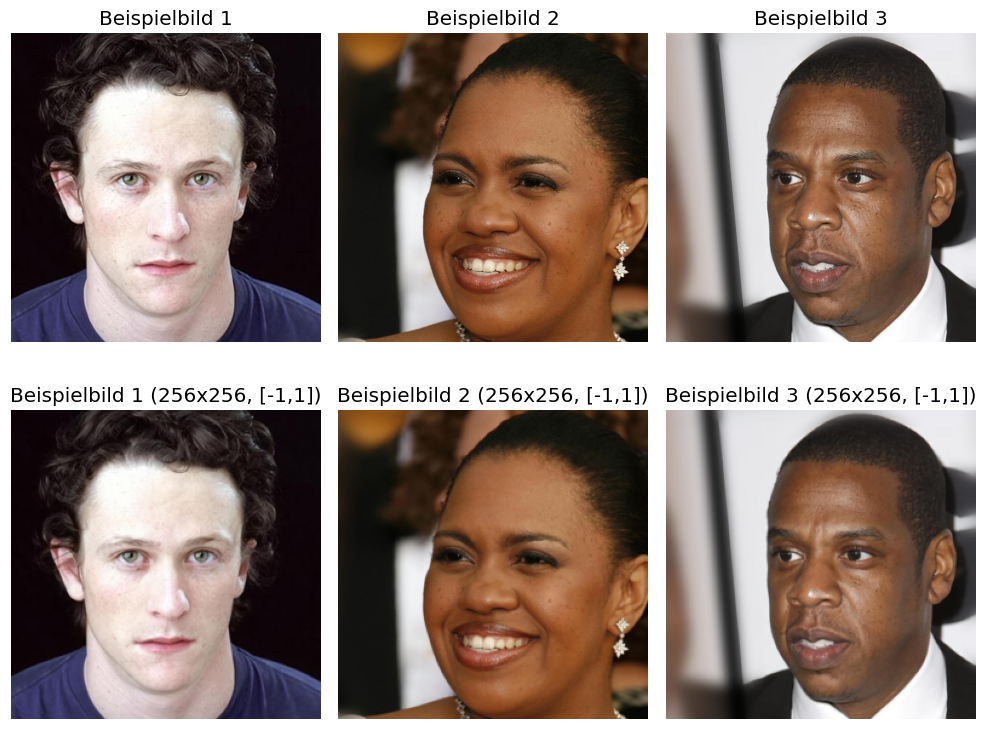

In [10]:
# Define the same preprocessing transform used in face_statistics.py
N_PIX = 256
transform = transforms.Compose(
    [
        transforms.Resize((N_PIX, N_PIX)),  # Resize to 32x32 pixels
        transforms.ToTensor(),  # Convert PIL Image to tensor [0,1]
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Rescale to [-1,1]
    ]
)

# Load example images (using a few exemplary JPG files)
image_paths = ["data/images/23979.jpg", "data/images/567.jpg", "data/images/11111.jpg"]
images = []
original_images = []

for path in image_paths:
    # Load original image for display
    original_img = Image.open(path).convert("RGB")
    original_images.append(original_img)

    # Apply preprocessing
    processed_img: np.ndarray = transform(original_img).numpy()
    images.append(processed_img)
    print(
        f"Loaded {path}: shape {processed_img.shape}, range [{processed_img.min():.3f}, {processed_img.max():.3f}]"
    )

# Display the images
fig, axes = plt.subplots(2, len(images), figsize=(10, 8))

for i, (orig_img, proc_img) in enumerate(zip(original_images, images)):
    # Original image
    axes[0, i].imshow(orig_img)
    axes[0, i].set_title(f"Beispielbild {i + 1}")
    axes[0, i].axis("off")

    # Processed image (convert from [-1,1] back to [0,1] for display)
    display_img = (proc_img + 1) / 2
    display_img = np.clip(display_img, 0, 1)  # Ensure values are in [0,1]
    axes[1, i].imshow(display_img.transpose(1, 2, 0), vmin=0, vmax=1)  # CHW to HWC
    axes[1, i].set_title(f"Beispielbild {i + 1} ({N_PIX}x{N_PIX}, [-1,1])")
    axes[1, i].axis("off")

plt.tight_layout()
plt.show()

## 3. Mittelwert und pixelweise Varianz der Gesichts-Bilder

Wir haben aus open-source Daten von 30000 Gesichtern bereits vorab den pixelweisen Mittelwert und die Varianz berechnet, also
$$ \mu = \frac 1 N \sum_{k=1}^N I_k, $$
$$ \Sigma = \frac{1}{N-1} \sum_{k=1}^N (I_k - \mu)^2, $$
mit $N=30000$ Bildern $I_k$ (das Quadrat in der Formel für Varianz ist hier pixelweise zu lesen). Wer nachlesen will, wie das genau entstanden ist, kann in `face_statistics.py` nachsehen. Dort findet sich der Download-Link zum gesamten 'CelebA-HQ' dataset (~4GB) und die Funktionen zum Berechnen und Speichern von Mittelwert & Varianz. Außerdem speichern wir dort die Werte eines einzelnen Pixels im Bild, an dem wir genau visualisieren können, wie der Diffusionsprozess die Verteilung ändert.

In der folgenden Zelle laden & plotten wir die vorberechneten Mittelwert- und Varianz-Bilder.

Mean image shape: (3, 256, 256)
Variance image shape: (3, 256, 256)
Mean range: [-0.6606, 0.7045]
Variance range: [0.0597, 0.4513]


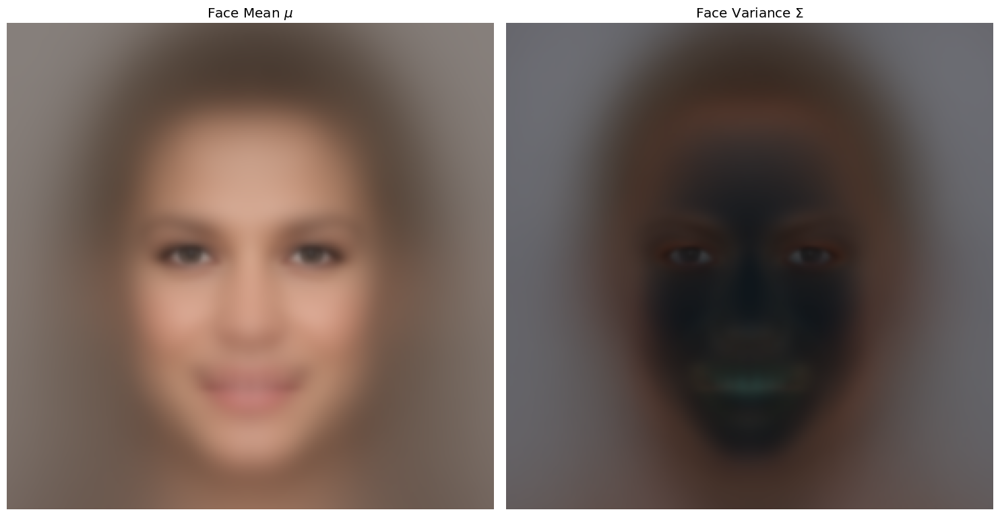

In [11]:
# Load mean and variance images
mean_image = np.load(f"statistics/mean{N_PIX}.npz")["mean"]
variance_image = np.load(f"statistics/variance{N_PIX}.npz")["variance"]

print(f"Mean image shape: {mean_image.shape}")
print(f"Variance image shape: {variance_image.shape}")
print(f"Mean range: [{mean_image.min():.4f}, {mean_image.max():.4f}]")
print(f"Variance range: [{variance_image.min():.4f}, {variance_image.max():.4f}]")

# Display
fig, axes = plt.subplots(1, 2, figsize=(15, 10))

# Convert mean from [-1,1] to [0,1] for display
mean_display = (mean_image + 1) / 2
mean_display = np.clip(mean_display, 0, 1)

# Display mean image
axes[0].imshow(mean_display.transpose(1, 2, 0), vmin=0, vmax=1)
axes[0].set_title(r"Face Mean $\mu$")
axes[0].axis("off")

# Display channel-wise variance as RGB
axes[1].imshow(variance_image.transpose(1, 2, 0), vmin=0, vmax=1, cmap="hot")
axes[1].set_title(r"Face Variance $\Sigma$")
axes[1].axis("off")

plt.tight_layout()
plt.show()

## 4. Ziehen von Samples aus der Zielverteilung

Zur Vereinfachung legen wir die Zielverteilung jetzt fest als die Gauss-Verteilung $\rho^* = \mathcal{N}(\mu, \Sigma)$. Dieses vereinfachte Modell geht davon aus, dass die Gesichtsbilder folgender statistischen Verteilung folgen: Alle Pixel sind stochastisch unabhängig voneinander und folgen jeweils einer ein-dimensionalen Gaussverteilung. Die Gaussverteilungen haben die Mittelwert und Varianz aus den oben sichtbaren $\mu$ und $\Sigma$.

Die Dichtefunktion dieser Verteilung ist
$$ \rho^*(x) \propto \exp\left(- \frac12 (x-\mu)^T \Sigma^{-1} (x-\mu)\right), $$
wobei $\mu$ der Mitelwert oben als Vektor der Länge `N_PIX**2` geschrieben ist, und die Kovarianzmatrix $\Sigma$ eine `N_PIX**2`x`N_PIX**2` Diagonalmatrix $\Sigma$ mit Einträgen aus dem Varianzbild oben ist.

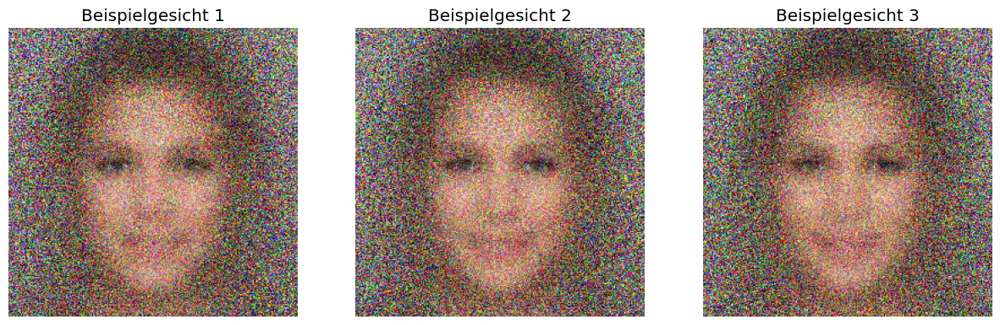

In [12]:
# [Aufgabe]: Ziehe drei Beispielbilder aus der Gaussverteilung und plotte sie.
example_image = rng.normal(size=((3,) + mean_image.shape)) * np.sqrt(
    variance_image[np.newaxis,...]
) + mean_image[np.newaxis,...]

fig, axes = plt.subplots(1, 3, figsize=(15, 10))
ex_display = (example_image + 1) / 2
ex_display = np.clip(ex_display, 0, 1)

# Display mean image
for i in range(3):
    axes[i].imshow(ex_display[i, ...].squeeze().transpose(1, 2, 0), vmin=0, vmax=1)
    axes[i].set_title(f"Beispielgesicht {i + 1}")
    axes[i].axis("off")

[Aufgabe]: Warum sind das keine realistischen Gesichtsbilder? Wo ist der Modellfehler, den wir machen, wenn wir annehmen, dass Gesichtsbilder einer Gaussverteilung mit diagonaler Kovarianzmatrix folgen?

# 5 Simulieren des Vorwärts-Prozess

Wir nehmen jetzt an, wir könnten aus irgendeinem Grund nicht direkt Samples aus $\rho^*$ ziehen wie in 4., sondern wollen dafür ein diffusion model verwenden. Dann setzen wir $p_0 = \rho^*$ und sehen uns den Vorwärts- und Rückwärtsprozess an.

In der DDPM-Formulierung ist der Übergang von Zeitpunkt $t-1$ zu $t$ definiert als
$$ x_t = \sqrt{\alpha_t} x_{t-1} + \sqrt{1-\alpha_t} \epsilon,\quad \epsilon \sim \mathcal N(0,I). $$
Die Koeffizienten $\alpha_t$ sind frei wählbar, üblicherweise z.B. $\alpha_t = 1-\beta_t$ mit $\beta_t = (1-t) \beta_{\min} + t \beta_{\max}$ und gewählten Konstanten $\beta_{\min}, \beta_{\max}$.

Hier kommt unsere vereinfachende Annahme von normalverteilten Gesichtern ins Spiel: Wenn $x_{t-1}$ normalverteilt ist, dann ist nach der Formel oben auch $x_t$ normalverteilt (warum?). Wenn der Prozess also bei $x_0 \sim \rho^* = \mathcal N(\mu, \Sigma)$ startet, dann ist 
$$\begin{align*} 
x_1 &= \sqrt{\alpha_1} x_0 + \sqrt{1-\alpha_1}\epsilon \\
&\sim \sqrt{\alpha_1} \mathcal N (\mu, \Sigma) + \sqrt{1-\alpha_1} \mathcal N(0,I) \\
&= \mathcal N (\sqrt{\alpha_1}\mu, \alpha_1\Sigma + (1-\alpha_1)I)
\end{align*}$$
Schreiben wir $\mu_1 = \sqrt{\alpha_1}\mu$ und $\Sigma_1 = \alpha_1\Sigma + (1-\alpha_1)I$, dann lässt sich dasselbe Argument wiederholen zu
$$\begin{align*} 
x_2 &= \sqrt{\alpha_2} x_1 + \sqrt{1-\alpha_2}\epsilon \\
&\sim \sqrt{\alpha_2} \mathcal N (\mu_1, \Sigma_1) + \sqrt{1-\alpha_2} \mathcal N(0,I) \\
&= \mathcal N (\sqrt{\alpha_2}\mu_1, \alpha_2\Sigma_1 + (1-\alpha_2)I),
\end{align*}$$
und so weiter. Aufgabe: Wenn $x_0$ normalverteilt ist, was sind die Parameter der Verteilung von $x_t$? Füge die Parameter unten im Code ein.

In [13]:
num_timesteps = 100
beta_start = 0.0001
beta_end = 0.2
betas = np.linspace(beta_start, beta_end, num_timesteps)

alphas = 1.0 - betas
alphas_cumprod = np.cumprod(alphas, axis=0)

means = np.sqrt(alphas_cumprod.reshape((-1, 1, 1, 1))) * mean_image[np.newaxis,...]
variances = alphas_cumprod.reshape((-1, 1, 1, 1)) * variance_image[np.newaxis,...] + (
    1 - alphas_cumprod.reshape((-1, 1, 1, 1))
) * np.ones((num_timesteps,) + variance_image.shape)

In `means` und `variances` sollten jetzt die Mittelwerte $\mu_t$ und die Diagonalen der Kovarianzen $\Sigma_t$ der Gaussverteilungen $\mathcal N(\mu_t, \Sigma_t)$ zu finden sein. Damit kennen wir die gesamte Wahrscheinlichkeitsverteilung von $x_t$ exakt. Bei Diffusionsmodellen ist das normalerweise nicht der Fall, und liegt hier an der speziellen Form zum Zeitpunkt $t=0$.

In [14]:
print(
    f"Means at all timesteps of shape: {means.shape}"
)  # Sollte (num_timesteps, 3, N_PIX, N_PIX) ergeben
print(
    f"Diagonals of covariances have shape: {variances.shape}"
)  # Sollte (num_timesteps, 3, N_PIX, N_PIX) ergeben

Means at all timesteps of shape: (100, 3, 256, 256)
Diagonals of covariances have shape: (100, 3, 256, 256)


## 5.1 Die Entwicklung der Wahrscheinlichkeitsverteilung über die Zeit

Die **Wahrscheinlichkeitsverteilung** von $x_t$ beschreibt den gesamten Zustand des Diffusionsprozesses zum Zeitpunkt $t$.
- Normalerweise kennen wir in Diffusionsprozessen nur einzelne **Samples** (Stichproben), also konkrete Beispiele, die aus dieser Verteilung gezogen werden

|      | Generelle Diffusionsprozesse | Im Spezialfall eines Gauss-verteilten $x_0$ |
|------|------------------------------|----------------------------|
| Wahrscheinlichkeitsverteilung von $x_t$ | i.A. unbekannt, eine "diffundierte Version" von $\rho^*$ | $\mathcal N(\mu_t, \Sigma_t)$ |
| Dichtefunktion der Verteilung | $ \propto \sqrt{\bar\alpha_t} \rho^* * \exp\left(-\frac{x^2}{2(1-\bar\alpha_t)}\right) $ | $\exp\left( -\frac{1}{2}(x-\mu_t)\Sigma_t^{-1}(x-\mu_t) \right)$ |
| Einzelne Samples | Generierbar mit $x_t = \sqrt{\bar\alpha_t}x_0 + \sqrt{1-\bar\alpha_t}\epsilon$ mit $x_0 \sim \rho^* $, $\epsilon \sim \mathcal N(0,I)$ | $x_t \sim \mathcal N(\mu_t, \Sigma_t)$, siehe Zelle mit Beispielgesichtern |

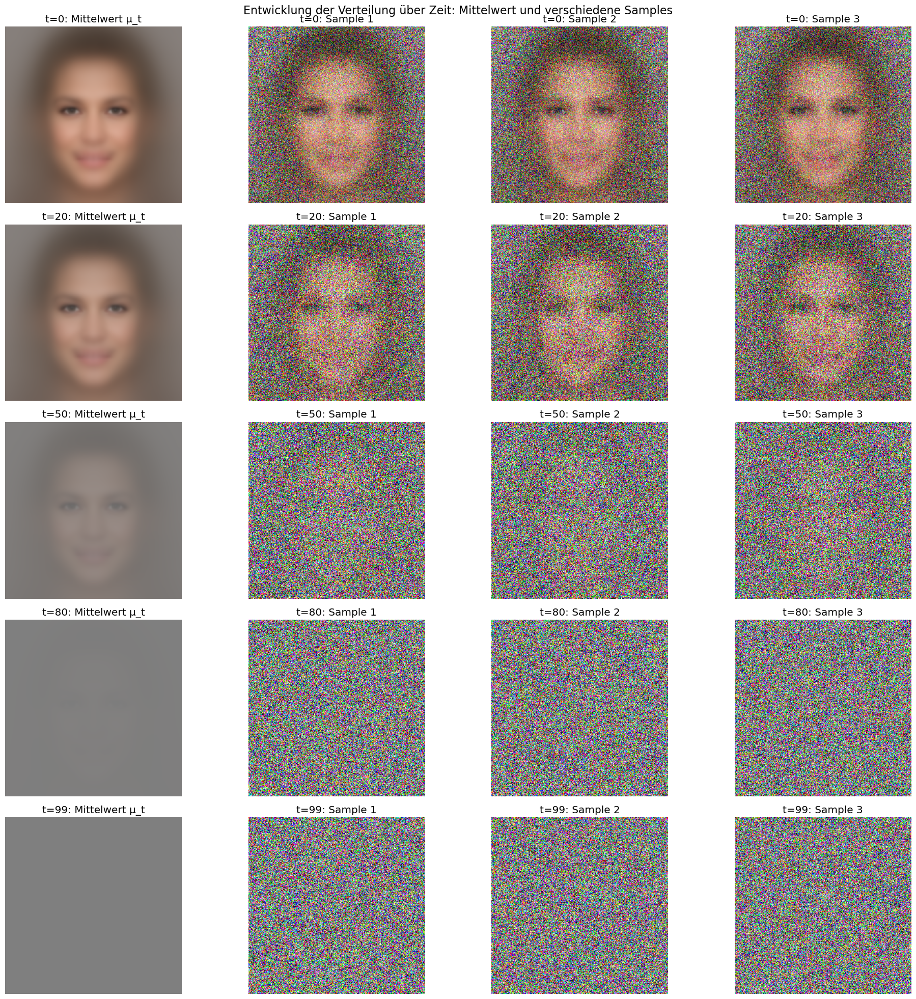

In [15]:
# Wähle verschiedene Zeitpunkte für die Visualisierung
timesteps_to_show = [0, 20, 50, 80, 99]
num_samples_per_timestep = 3

fig, axes = plt.subplots(
    len(timesteps_to_show),
    num_samples_per_timestep + 1,
    figsize=(20, 4 * len(timesteps_to_show)),
)

for i, t in enumerate(timesteps_to_show):
    # Ziehe mehrere Samples aus der Verteilung zum Zeitpunkt t
    samples = (
        rng.normal(size=(num_samples_per_timestep,) + mean_image.shape)
        * np.sqrt(variances[t])
        + means[t]
    )

    # Zeige den Mittelwert der Verteilung
    mean_display = (means[t] + 1) / 2
    mean_display = np.clip(mean_display, 0, 1)
    axes[i, 0].imshow(mean_display.transpose(1, 2, 0), vmin=0, vmax=1)
    axes[i, 0].set_title(f"t={t}: Mittelwert μ_t")
    axes[i, 0].axis("off")

    # Zeige die verschiedenen Samples
    for j in range(num_samples_per_timestep):
        sample_display = (samples[j] + 1) / 2
        sample_display = np.clip(sample_display, 0, 1)
        axes[i, j + 1].imshow(sample_display.transpose(1, 2, 0))
        axes[i, j + 1].set_title(f"t={t}: Sample {j + 1}")
        axes[i, j + 1].axis("off")

plt.suptitle(
    "Entwicklung der Verteilung über Zeit: Mittelwert und verschiedene Samples",
    fontsize=16,
)
plt.tight_layout()
plt.show()

**Was können wir beobachten?**

1. **t=0**: Die Samples sehen noch wie (unrealistische) Gesichter aus, da sie aus der ursprünglichen Verteilung stammen
2. **Mittlere Zeitpunkte**: Die Samples werden zunehmend verrauschter, aber behalten noch Struktur
3. **t=99**: Die Samples sind praktisch reines Rauschen - die Verteilung ist fast $\mathcal{N}(0,I)$

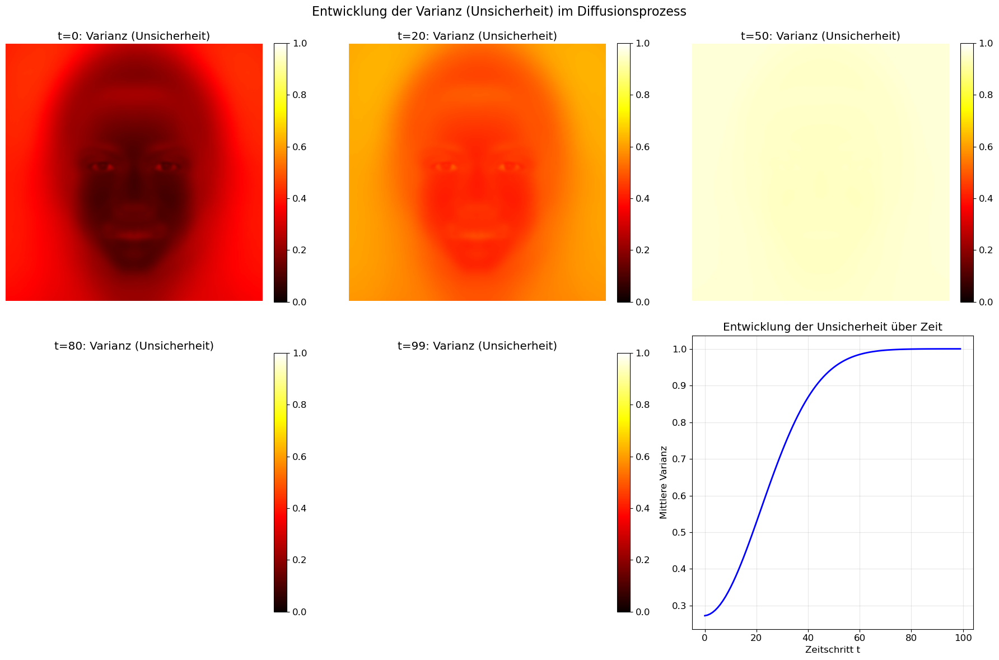

In [16]:
# Zusätzliche Visualisierung: Varianz über die Zeit
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Zeige wie sich die Varianz über die Zeit entwickelt
timesteps_var = [0, 20, 50, 80, 99]
for i, t in enumerate(timesteps_var):
    if i < 5:  # Nur die ersten 5 Zeitpunkte
        row = i // 3
        col = i % 3

        # Mittlere Varianz über alle Pixel und Kanäle
        var_image = variances[t].mean(axis=0)  # Mitteln über Kanäle

        im = axes[row, col].imshow(
            var_image, vmin=0, vmax=1, cmap="hot"
        )
        axes[row, col].set_title(f"t={t}: Varianz (Unsicherheit)")
        axes[row, col].axis("off")
        plt.colorbar(im, ax=axes[row, col], fraction=0.046, pad=0.04)

# Letztes Subplot: Entwicklung der mittleren Varianz über Zeit
axes[1, 2].plot(range(num_timesteps), variances.mean(axis=(1, 2, 3)), "b-", linewidth=2)
axes[1, 2].set_xlabel("Zeitschritt t")
axes[1, 2].set_ylabel("Mittlere Varianz")
axes[1, 2].set_title("Entwicklung der Unsicherheit über Zeit")
axes[1, 2].grid(True, alpha=0.3)

plt.suptitle("Entwicklung der Varianz (Unsicherheit) im Diffusionsprozess", fontsize=16)
plt.tight_layout()
plt.show()

### 5.2 Verteilung eines einzelnen Pixel

Um das Verhalten der Wahrscheinlichkeitsverteilungen in Diffusionsmodellen besser zu verstehen, schauen wir uns die **marginale Verteilung eines einzelnen Pixels** an. Jeder Pixel hat drei Farbkanäle (RGB) und nimmt somit einen Punkt im 3D-Raum an.

In `face_statistics.py` haben wir die Werte eines einzelnen Pixels (z.B. in der Augenregion) aus allen Bildern extrahiert. Die Verteilung der RGB-Werte über alle Bilder wird in der folgenden Zelle visualisiert.

In [17]:
# Lade die Werte eines einzelnen Pixels aus allen Gesichts-Bildern aus `face-statistics.py`
EYE_R = 122
EYE_C = 95
pixels = np.load('./eye_pixels/pixel_values256.npz')['pixel_values'] # Shape (n_images, 3)

po.init_notebook_mode()

pixels_rgb = pixels.astype(np.uint8)
# we'll color every point in the scatterplot with the color it represents
colors = ['rgb({},{},{})'.format(r, g, b) for r, g, b in pixels_rgb]

fig = go.Figure(
    data=go.Scatter3d(
        x=pixels_rgb[:, 0],  # Red
        y=pixels_rgb[:, 1],  # Green
        z=pixels_rgb[:, 2],  # Blue
        mode='markers',
        marker=dict(
            size=3,
            color=colors,
            opacity=0.7
        )
    )
)
fig.update_xaxes(range=[0,255])
fig.update_yaxes(range=[0,255])
fig.update_layout(
    autosize=False,
    width=800,
    height=600,
    scene=dict(
        xaxis_title='Red',
        yaxis_title='Green',
        zaxis_title='Blue',
    ),
    title='RGB Distribution of Eye Pixel',
    margin=dict(l=0, r=0, b=0, t=30)
)

fig.show()

Die folgende Zelle zeigt erneut die einzelnen Werte der Pixel. Darüber legen wir eine gefittete 3D Gaussverteilung (dieses Mal mit dichter Kovarianzmatrix), die die Verteilung der Pixelwerte approximiert.

In [18]:
# Normalize pixels to [-1,1] and compute mean and covariance
pixels_norm = ((pixels_rgb / 255.0) - 0.5)/0.5
mean_3d = pixels_norm.mean(axis=0)
print(f"3D Gaussian mean: {mean_3d}")
cov_3d = np.cov(pixels_norm.T)  # .T because np.cov expects features as rows
print(f"3D Gaussian covariance matrix:\n{cov_3d}")

# Compare with diagonal 3x3 approximation
# cov_diagonal = np.diag(np.var(pixels_norm, axis=0))
# print(f"Diagonal approximation:\n{cov_diagonal}")

# Create ellipsoid surface using eigendecomposition
# For a 3D Gaussian, the ellipsoid is defined by (x-μ)ᵀ Σ⁻¹ (x-μ) = k²
# where k determines the number of standard deviations to plot, 
# proportional to confidence levels (k=1.0 for ~68% of data sampled from a Gaussian)
def create_ellipsoid_surface(mean, cov, k=1.0, n_points=25):
    """Create ellipsoid surfaces for 3D Gaussian visualization"""

    # Generate points on unit sphere
    u = np.linspace(0, 2 * np.pi, n_points)
    v = np.linspace(0, np.pi, n_points//2)
    
    # Unit sphere coordinates
    x_sphere = np.outer(np.cos(u), np.sin(v))
    y_sphere = np.outer(np.sin(u), np.sin(v))
    z_sphere = np.outer(np.ones_like(u), np.cos(v))
    
    # Stack coordinates and reshape for matrix operations
    sphere_points = np.stack([x_sphere.flatten(), y_sphere.flatten(), z_sphere.flatten()])
    
    # Transform unit sphere using Cholesky decomposition of covariance
    L = np.linalg.cholesky(cov)
    
    ellipsoid_points = mean[:, np.newaxis] + k * L @ sphere_points
    
    # Reshape back to grid format
    x_ellipsoid = ellipsoid_points[0].reshape(x_sphere.shape)
    y_ellipsoid = ellipsoid_points[1].reshape(y_sphere.shape)
    z_ellipsoid = ellipsoid_points[2].reshape(z_sphere.shape)
    
    return x_ellipsoid, y_ellipsoid, z_ellipsoid


fig_3d = go.Figure()

# Scatter diffused data points
fig_3d.add_trace(go.Scatter3d(
    x=pixels_norm[:, 0], # Red at time t
    y=pixels_norm[:, 1], # Green at time t
    z=pixels_norm[:, 2], # Blue at time t
    mode='markers',
    marker=dict(
        size=3,
        color=colors,
        opacity=0.7
    )
))

for k in [1.0, 2.0, 3.0]:
    # Create ellipsoid for k-sigma confidence region at time t
    x_ell, y_ell, z_ell = create_ellipsoid_surface(mean_3d, cov_3d, k=k)

    # Add full covariance ellipsoid
    fig_3d.add_trace(go.Surface(
        x=x_ell,
        y=y_ell,
        z=z_ell,
        opacity=0.3/k,
        colorscale='Reds',
        showscale=False,
    ))

fig_3d.update_layout(
    autosize=False,
    width=900,
    height=700,
    scene=dict(
        xaxis_title='Red',
        yaxis_title='Green',
        zaxis_title='Blue',
        xaxis=dict(range=[-1, 1]),
        yaxis=dict(range=[-1, 1]),
        zaxis=dict(range=[-1, 1])
    ),
    title='Approximation der Verteilung eines Pixels durch eine Gauss-Verteilung',
    margin=dict(l=0, r=0, b=0, t=50)
)

fig_3d.show()

3D Gaussian mean: [-0.47942248 -0.56467451 -0.60419948]
3D Gaussian covariance matrix:
[[0.11522502 0.10456097 0.09647042]
 [0.10456097 0.10793985 0.10503561]
 [0.09647042 0.10503561 0.11011075]]


Jetzt diffundieren wir die empirische Verteilung und die gefittete Gaussverteilung. Mit dem Slider unten lässt sich die Zeitvariable verändern.

In [22]:
# diffused mean and covariance in time
mean_t_3d = np.sqrt(alphas_cumprod.reshape((-1, 1))) * mean_3d[np.newaxis, ...]
cov_t_3d = alphas_cumprod.reshape((-1, 1, 1)) * cov_3d[np.newaxis, ...] + (
    1 - alphas_cumprod.reshape((-1, 1, 1))
    ) * np.eye(3)[np.newaxis, ...]

# Creates a new figure showing the evolution of the scattered data and a 3D Gaussian ellipsoid along the diffusion process
def create_combined_3d_plot():
    fig_3d = go.Figure()
    
    timesteps_to_show = range(0, 100, 5)
    
    for t in timesteps_to_show:
        visibility = True if t==timesteps_to_show[0] else 'legendonly'

        # Scatter diffused data points - only 1/10th of all points to save computation
        pixels_t = np.sqrt(alphas_cumprod[t])*pixels_norm[::10] + np.sqrt(1-alphas_cumprod[t])*rng.normal(size=pixels_norm[::10].shape)
        fig_3d.add_trace(go.Scatter3d(
            x=pixels_t[:, 0], # Red at time t
            y=pixels_t[:, 1], # Green at time t
            z=pixels_t[:, 2], # Blue at time t
            mode='markers',
            marker=dict(
                size=3,
                color=colors[::10],
                opacity=0.7
            ),
            visible=visibility
        ))

        # for k in [1.0, 2.0, 3.0]:
        k = 1.0
        # Create ellipsoid for 1-sigma confidence region at time t
        x_ell, y_ell, z_ell = create_ellipsoid_surface(mean_t_3d[t,...], cov_t_3d[t,...], k=k)

        # Add full covariance ellipsoid
        fig_3d.add_trace(go.Surface(
            x=x_ell,
            y=y_ell,
            z=z_ell,
            opacity=0.3/k,
            colorscale='Reds',
            showscale=False,
            visible=visibility
        ))

    steps = []
    for i, t in enumerate(timesteps_to_show):
        step = dict(
            method="update",
            args=[{"visible": [False] * len(fig_3d.data)}],
            label=f"t={t}"
        )
        # Zeige alle Traces für diesen Zeitpunkt
        for j in range(2):
            step["args"][0]["visible"][2*i + j] = True
        steps.append(step)

    sliders = [dict(
            active=0,
            currentvalue={"prefix": "Zeitschritt: "},
            pad={"t": 50},
            steps=steps
        )]

    fig_3d.update_layout(
        autosize=False,
        width=900,
        height=700,
        scene=dict(
            xaxis_title='Red',
            yaxis_title='Green',
            zaxis_title='Blue',
            xaxis=dict(range=[-2, 2]),
            yaxis=dict(range=[-2, 2]),
            zaxis=dict(range=[-2, 2])
        ),
        sliders=sliders,
        title='Approximation der Verteilung eines Pixels durch eine Gauss-Verteilung',
        margin=dict(l=0, r=0, b=0, t=50)
    )

    fig_3d.update_layout(showlegend=False)
    return fig_3d

fig_3d = create_combined_3d_plot()
fig_3d.show()

# 6 [TODO] Mache inverses Problem daraus

[TODO] man könnte ein simples SR-Problem hieraus machen, eine Messung $y$ machen, Gauss noise addieren, und dann aus dem posterior samplen
Wenn 
$$ \rho_{\text{prior}}(x) \propto \exp\left(- \frac12 (x-\mu_{\text{prior}})^T \Sigma_{\text{prior}}^{-1} (x-\mu_{\text{prior}})\right) $$
und
$$ \rho_{\text{like}}(y\,|\,x) \propto \exp\left(- \frac{||Ax-y||^2}{2\sigma_{\text{like}}^2}\right) $$
für ein simples lineares $A$, dann ist
$$ \begin{align*} \rho_{\text{post}}(x\,|\,y) &\propto \exp\left( - \frac12 (x-\mu_{\text{prior}})^T \Sigma_{\text{prior}}^{-1} (x-\mu_{\text{prior}}) - \frac{||Ax-y||^2}{2\sigma_{\text{like}}^2} \right)\\ &= \exp\left( -\frac{1}{2}(x-\mu_{\text{post}})^T \Sigma_{\text{post}}^{-1} (x-\mu_{\text{post}})\right) \end{align*}$$
mit passend berechneten $\mu_{\text{post}}, C_{\text{post}}$. Nach Kaipio & Somersalo Thm 3.7 ist 
$$ 
\begin{align*}
\mu_{\text{post}} &= \mu_{\text{prior}} + \Sigma_{\text{prior}} A^T (A \Sigma_{\text{prior}} A^T + \sigma^2 I)^{-1}(y-A\mu_{\text{prior}})\\
\Sigma_{\text{post}} &= \Sigma_{\text{prior}} - \Sigma_{\text{prior}} A^T (A \Sigma_{\text{prior}} A^T + \sigma^2 I)^{-1} A \Sigma_{\text{prior}}
\end{align*}
$$